# CA computation for paper
### Using CA_arena and Create_expanding_rings templates 

Create a 1000x1000 arena, and iterate cell formation according to an expanding-rings conditional probability, modeled on the IR satellite result over South America. 

A main question is: Do large-scale and low frequency patterns emerge from a conditional p' pattern that is bounded in space and time? Call such a bounded pattern a "KERNEL". 

One important parameter for larger scales might seem to be the NET probability enhancement over the kernel. If this is positive, clumping can run away at the kernel's bounding=box scales as in the Create_arena notebook example with its positive-only kernel. If negative, we will probably get oscillating exclusions shaped by that kernel outer scale boundary and/or the domain periodic boundaries, perhaps like the "diurnal dancing" of Chen and Houze (WIGWs was it?). Neither of these degenerate cases is of interest here. 

One challenge with an additive probability formulation is that p is nonnegative. But if the kernel is viewed as log-probability, then 2**kernel is a nonnegative factor. This is what the data analysis yielded anyway. So let's make a pcondfactor, not an additive pcond, multiplying a BACKGROUND probability pbar, which is the initial condition. 

Far from any cells, beyond the kernel's outer size, pcondfactor=1 (2**0), p = pbar remains climatological. The clusters and patterns cannot run away or collapse. 

prob = pmean * pcondfactor 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

In [107]:
# DEFINE ARENA 

# Constants
SIZE = 300
PMEAN = 0.01         # 0.001 means ~250 new cells each step in 500x500 array 

# Initialize probability map
pbar = np.full((SIZE, SIZE), PMEAN)
pcondfactor = np.zeros_like(pbar) + 1 
prob = pbar*pcondfactor

# Initialize grid of cell age at zero
# They will age until overwritten with 1 at birth. 
cell_age = np.zeros((SIZE, SIZE), dtype=int)

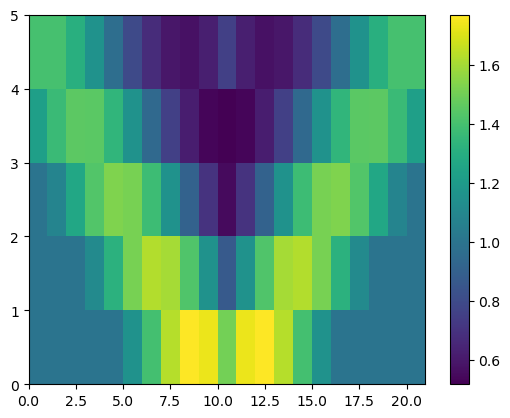

In [233]:
# DEFINE KERNEL 
kernel = np.load('/Users/bmapes/Github/EvolutionaryConvection/Probability_kernel_iteration/pkernel_21x21x5.numpy.npy')
kernelfactor = 2**kernel

KERNEL_SIZE = kernel.shape[2]      # 21x21 gridpoints, symmetric on a central point
KERNEL_TIME = kernel.shape[0]      # number of cell lifetimes that pcondfactor is affected

# In the paper, values in [-0.3,0.3] are log2 of a probability enhancement factor. 
# Multiply 2**kernel by pmean to get the total probability. 

plt.pcolormesh( kernelfactor[:,:,10] ); plt.colorbar()

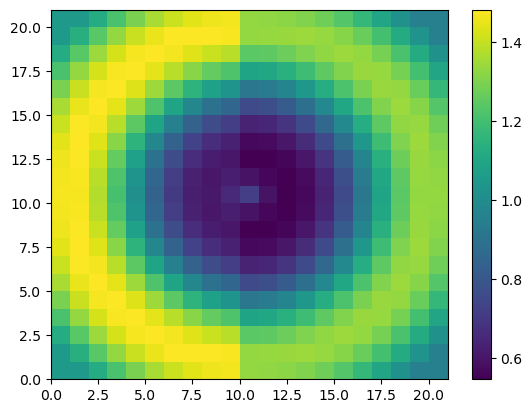

In [184]:
# KERNEL EXPERIMENTS 

# One time duration: Markovian in time 
KERNEL_TIME = 1 

#small kernel, net positive: makes "MCS" about 50 pixels 
kernelfactor = 2**kernel[4,:,:]

# Bigger pattern, strong hole in the middle. Hole makes blobs w cavities @ CLIPFACTOR=20
# kernelfactor = 2**kernel[3,:,:]

# DIVIDE BY the area-mean of the FACTOR - so area average is muted: no org just ripples
#kernelfactor /= (np.mean(kernelfactor))

# ASYMMETRY: yes, leftward propagation
kernelfactor[:,:10] *= 1.05
kernelfactor[:,10:] *= 0.95

plt.pcolormesh( kernelfactor ); plt.colorbar()

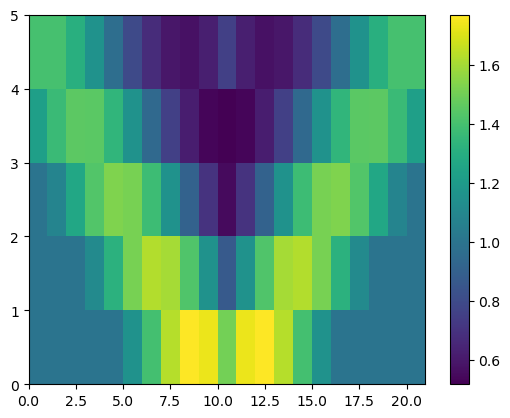

In [186]:
# KERNEL lasts 5 times so it isn't all flickering, use expanding ring
KERNEL_TIME = 5
kernelfactor = 2**kernel[:,:,:]

plt.pcolormesh( kernelfactor[:,:,10] ); plt.colorbar()

In [187]:
np.mean(kernelfactor)

np.float64(1.1502867189171961)

In [188]:
kernelfactor.shape

(5, 21, 21)

In [220]:
# Update(frame) does one time step 

def update(frame):
    # global variables: not best practice, but lucid for debugging and playing  
    global new_cells, cell_age, pbar, pcondfactor, prob, CLIPFACTOR, DIURNAL_AMP   
    
    # Age all existing cells by 1, zeros remain unchanged.
    cell_age = np.where(cell_age>0.99, cell_age+1, cell_age)

    # Create new cells based on probability map (Boolean)
    new_cells = np.random.random((SIZE, SIZE)) < (prob)
    
    # Overwrite cell_age with 1 where a new cell is located 
    cell_age = np.where(new_cells, 1, cell_age) 

    
    # Update total probability map, prob = pbar * pcondfactor    
    
    # pcondfactor: Loop over KERNEL_TIME, multiplying kernelfactor from cells of that age 
    pcondfactor = np.zeros_like(pbar) + 1.0
    
    for iage in range(KERNEL_TIME): 
        age = iage+1 # 
        active_cells = np.where( (cell_age==age) )
        for i, j in zip(*active_cells):
            i_start = (i - KERNEL_SIZE // 2) % SIZE
            j_start = (j - KERNEL_SIZE // 2) % SIZE
            i_indices = np.arange(i_start, i_start + KERNEL_SIZE) % SIZE
            j_indices = np.arange(j_start, j_start + KERNEL_SIZE) % SIZE
            # A patch of kernel application
            pcondfactor[np.ix_(i_indices, j_indices)] *= kernelfactor[iage,:,:]

    prob = pbar*pcondfactor 
    
    # Clip values, it does seen to have a runaway problem with positivity 
    prob = np.clip(prob, 0, CLIPFACTOR*PMEAN)

    # Rescale total prob to PMEAN, prevent drift. WTG-like instant subsidence 
    prob *= PMEAN/np.mean(prob)
    
    # prob has a diurnal cycle, must not exceed 1 to keep probability positive 
    if (DIURNAL_AMP>=1):
        DIURNAL_AMP=0.99
    prob *= ( 1 + DIURNAL_AMP * np.sin(2*np.pi *frame/24) )

    # Update image : mean age version
    # im.set_array(cell_age)
    # plt.title(f"Step: {frame}, Mean age of cells: {np.mean(cell_age)}")

    # Update image: prob version 
    im.set_array(prob)
    plt.title(f"Step: {frame}")

    # Print debugging information
    #print(f"Step {frame}: Min prob = {prob.min():.6f}, Max prob = {prob.max():.6f}, Mean prob = {np.mean(prob)}")
    
    return [im]

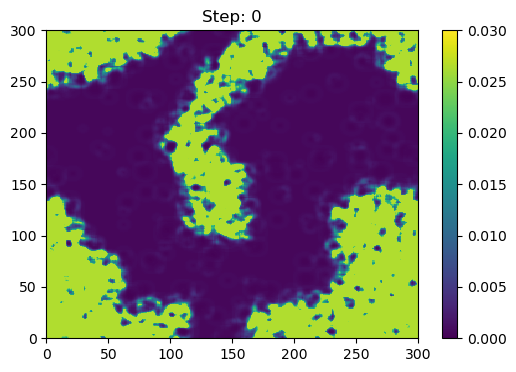

In [234]:
# RUN AND ANIMATE RESULTS 
TIMESTEPS = 100
# CLIPFACTOR = 50  # how high above PMEAN can the local p get? Prevents runaway storms 
DIURNAL_AMP = 0    # background probability constant in time

# Initialize probability map
pbar = np.full((SIZE, SIZE), PMEAN)
pcondfactor = np.zeros_like(pbar) + 1. 
prob = pbar * pcondfactor

# Initialize grid of cell age
cell_age = np.zeros((SIZE, SIZE), dtype=int)

fig, ax = plt.subplots(figsize=(6,4))
im = ax.pcolormesh(prob, vmin=0, vmax=PMEAN*3)
plt.colorbar(im)
plt.title("Cellular Automaton")

# Create the animation
anim = FuncAnimation(fig, update, frames=TIMESTEPS, interval=50, repeat=False)

# Display the animation
HTML(anim.to_jshtml())

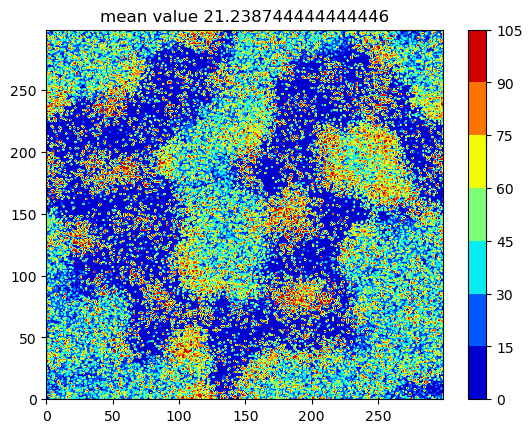

In [235]:
plt.contourf(cell_age, cmap='jet'); plt.colorbar(); plt.title('mean value '+str(np.mean(cell_age)) );

# Add a diurnal cycle: treat timestep as 1 hour
### Let's give PMEAN a 24 hour sine wave

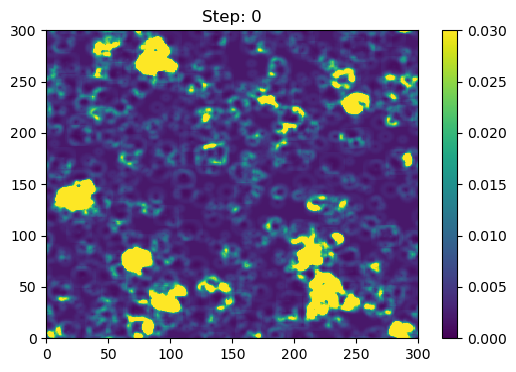

In [238]:
# RUN AND ANIMATE RESULTS 
TIMESTEPS = 24*4
# CLIPFACTOR = 50  # how high above PMEAN can the local p get? Prevents runaway storms 
DIURNAL_AMP = 0.9    # 1 => background probability goes to 0 at midnight --> error /0 

# Initialize probability map
pbar = np.full((SIZE, SIZE), PMEAN)
pcondfactor = np.zeros_like(pbar) + 1. 
prob = pbar * pcondfactor

# Initialize grid of cell age
cell_age = np.zeros((SIZE, SIZE), dtype=int)

fig, ax = plt.subplots(figsize=(6,4))
im = ax.pcolormesh(prob, vmin=0, vmax=PMEAN*3)
plt.colorbar(im)
# plt.title("Cellular Automaton")

# Create the animation
anim = FuncAnimation(fig, update, frames=TIMESTEPS, interval=50, repeat=False)

# Display the animation
HTML(anim.to_jshtml())

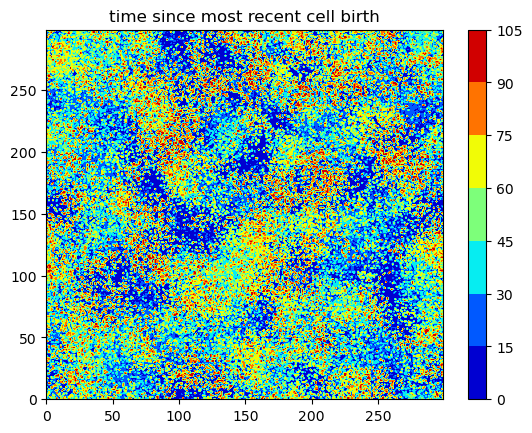

In [240]:
plt.contourf(cell_age, cmap='jet'); plt.colorbar(); plt.title("time since most recent cell birth");

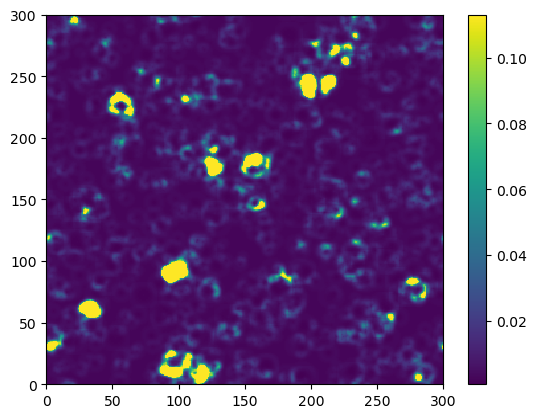

In [231]:
plt.pcolormesh(prob); plt.colorbar(); 